## Calculation of pixel wise correlations between ALOS-2 and Net water raster time series

#### Quickstart version - uses outputs from Pixel_wise_correlation.ipynb

**Outputs**
- maximum time to correlation data
- Figures 6 and 8 in the paper

In [1]:
import sys
import pandas as pd
import xarray as xr
import numpy as np
xr.set_options(cmap_sequential='jet')
import matplotlib.pyplot as plt
import warnings
import netCDF4
import datetime
import plotly
import plotly.express as px
import plotly.graph_objects as go
from affine import Affine
import cartopy.crs as ccrs
import nco
import xesmf as xe
from calendar import monthrange
import pickle as pkl
from datetime import date, timedelta
import math
import matplotlib
import cartopy.crs as ccrs
from matplotlib.pyplot import figure
import matplotlib.colors as colors
import seaborn as sns

plt.rcParams['figure.dpi'] = 800

In [2]:
# Important to set this environment variable so that netcdf files can be opened.
%env HDF5_USE_FILE_LOCKING=FALSE

env: HDF5_USE_FILE_LOCKING=FALSE


In [1]:
# define input and output directories here


### Function declarations

In [12]:
def calculate_optimal_T_v0(da,target,var_name):
    # calculates the optimal net water input time period to accumulate over (e.g. max corr/cov/slope or min p-value)
    # da = array of ndays stats, e.g. pixel-wise correlations, slopes, or p-values for n accumulation periods
    # target = min (for pvalue/stderr) or max (corr, cov, slope)
    if target == 'max':
        da_new = da.idxmax(dim='time',skipna=True)
    else: 
        da_new = da.idxmin(dim='time',skipna=True)
        
    df = da_new.to_dataframe().reset_index()

    # reassigning datatype from string to integer
    values = [np.nan] + ndays
    keys = [str(x) for x in values]
    dictionary = dict(zip(keys,values))
    
    # replacing the column values using a dictionary
    df[var_name] = df[var_name].replace(dictionary)
    
    print (df)

    ds = df.set_index(keys = ['lat','lon']).to_xarray()

    return ds

In [81]:
def run_pixel_wise_correlations(da1,da2,ndays,file_id):
    # a function to run the function that calculates the pixel wise correlation statistics 
    # for each nw days accumulation period prior to the ALOS-2 image date. 
    # the outputs of this function are: cov,cor,slope,intercept,pval,stderr
    # example usage: run_pixel_wise_correlations(nw_accums,HH_db_100m['db'][:-2],ndays_array,'HH')
    # re-run this using delta_HH_db_100m instead of HH_db_100m (the difference between subsequent dates - this would
    # make more sense)
    
    covs = []   # covariances
    corrs = []   # correlations
    slopes = []   # slopes
    intercepts = []   # intercepts
    pvals = []   # p-values
    stderrs = []   # std errors 
    
    for i in range(len(ndays)):
    #for i in range(1):
        print ("ndays: " + str(ndays[i]))
        cov, cor, slope, intercept, pval, stderr = lag_linregress_3D(da1[i], da2, lagx=0, lagy=0)

        # appending the stats for accumulation period = ndays
        covs.append(cov)
        corrs.append(cor)
        slopes.append(slope)
        intercepts.append(intercept)
        pvals.append(pval)
        stderrs.append(stderr)
        
    # concatenating each resulting stats array into a single xarray data array
    # in this case, the time dimension is ndays, rather than a datetime
    print ("renaming the dimension...")
    corrs_da = xr.concat(corrs,dim='net water').rename({"net water": "time"})
    #covs_da = xr.concat(covs,dim='net water').rename({"net water": "time"})
    slopes_da = xr.concat(slopes,dim='net water').rename({"net water": "time"})
    #intercepts_da = xr.concat(intercepts,dim='net water').rename({"net water": "time"})
    pvals_da = xr.concat(pvals,dim='net water').rename({"net water": "time"})
    stderrs_da = xr.concat(stderrs,dim='net water').rename({"net water": "time"})
    
    # concatenating each resulting stats array into a single xarray data array
    # in this case, the time dimension is ndays, rather than a datetime
    #print ("renaming the dimension...")
    #corrs_da = xr.concat(corrs,dim='time')
    #covs_da = xr.concat(covs,dim='time')
    #slopes_da = xr.concat(slopes,dim='time')
    #intercepts_da = xr.concat(intercepts,dim='time')
    #pvals_da = xr.concat(pvals,dim='time')
    #stderrs_da = xr.concat(stderrs,dim='time')

    # saving to netcdf
    print ("saving to netcdf...")
    corrs_da.to_netcdf(path=ALOS_OUT + 'corrs_da_' + file_id + '_ndays_final.nc')
    slopes_da.to_netcdf(path=ALOS_OUT + 'slopes_da_' + file_id + '_ndays_final.nc')       
    pvals_da.to_netcdf(path=ALOS_OUT + 'pvals_da_' + file_id + '_ndays_final.nc')
    stderrs_da.to_netcdf(path=ALOS_OUT + 'stderrs_da_' + file_id + '_ndays_final.nc') 
    #intercepts_da.to_netcdf(path=ALOS_OUT + 'intercepts_da_' + file_id + '_ndays.nc')
    #covs_da.to_netcdf(path=ALOS_OUT + 'covs_da_' + file_id + '_ndays.nc')
    

    
    return (corrs_da, slopes_da, pvals_da, stderrs_da)
    

In [79]:
def calculate_optimal_T(da,target,var_name):
    # calculates the optimal net water input time period to accumulate over (e.g. max corr/cov/slope or min p-value)
    # da = array of ndays stats, e.g. pixel-wise correlations, slopes, or p-values for n accumulation periods
    # target = min (for pvalue/stderr) or max (corr, cov, slope)
    if target == 'max':
        da_new = da.idxmax(dim='time',skipna=True)
    else: 
        da_new = da.idxmin(dim='time',skipna=True)

    df = da_new.to_dataframe().reset_index()
    # reassigning datatype from string to integer (used originally when all time entries had the label: days)
    values = [np.nan] + ndays
    keys = [str(x) for x in values]
    dictionary = dict(zip(keys,values))

    print (dictionary)
    # replacing the column values using a dictionary
    #df['correlation'] = df['correlation'].replace(dictionary)

    ds = df.set_index(keys = ['lat','lon']).to_xarray()
    
    return (ds)

In [4]:
# pixel wise correlation function 
# by AWilliams: https://stackoverflow.com/questions/58546999/calculate-correlation-in-xarray-with-missing-data

def lag_linregress_3D(x, y, lagx=0, lagy=0):
    """
    Input: Two xr.Datarrays of any dimensions with the first dim being time. 
    Thus the input data could be a 1D time series, or for example, have three 
    dimensions (time,lat,lon). 
    Datasets can be provided in any order, but note that the regression slope 
    and intercept will be calculated for y with respect to x.
    Output: Covariance, correlation, regression slope and intercept, p-value, 
    and standard error on regression between the two datasets along their 
    aligned time dimension.  
    Lag values can be assigned to either of the data, with lagx shifting x, and
    lagy shifting y, with the specified lag amount. 
    """ 
    #1. Ensure that the data are properly alinged to each other. 
    x,y = xr.align(x,y)

    #2. Add lag information if any, and shift the data accordingly
    if lagx!=0:

        # If x lags y by 1, x must be shifted 1 step backwards. 
        # But as the 'zero-th' value is nonexistant, xr assigns it as invalid 
        # (nan). Hence it needs to be dropped
        x   = x.shift(time = -lagx).dropna(dim='time')

        # Next important step is to re-align the two datasets so that y adjusts
        # to the changed coordinates of x
        x,y = xr.align(x,y)

    if lagy!=0:
        y   = y.shift(time = -lagy).dropna(dim='time')
        x,y = xr.align(x,y)

    #3. Compute data length, mean and standard deviation along time axis: 
    n = y.notnull().sum(dim='time')
    xmean = x.mean(axis=0)
    ymean = y.mean(axis=0)
    xstd  = x.std(axis=0)
    ystd  = y.std(axis=0)

    #4. Compute covariance along time axis
    cov   =  np.sum((x - xmean)*(y - ymean), axis=0)/(n-1)

    #5. Compute correlation along time axis
    cor   = cov/(xstd*ystd)

    #6. Compute regression slope and intercept:
    slope     = cov/(xstd**2)
    intercept = ymean - xmean*slope  

    #7. Compute P-value and standard error
    #Compute t-statistics
    tstats = cor*np.sqrt(n-2)/np.sqrt(1-cor**2)
    stderr = slope/tstats

    from scipy.stats import t
    pval   = t.sf(tstats, n-2)
    pval   = xr.DataArray(pval, dims=cor.dims, coords=cor.coords)

    return cov,cor,slope,intercept,pval,stderr

In [5]:
# defining the bounds of the Cuvette Centrale region - taken from the veg grid in CHIRPS_AET_calculation_full_CC.ipynb
lat_min = -5.06319436
lat_max = 3.29741657
lon_min = 14.99769448
lon_max = 25.78052774

In [64]:
%%time
# open the alos-2 and daily net water regridded files (output from Process_ALOS_areas.ipynb)

nw_daily_100m = xr.open_dataset(ALOS_OUT + 'nw_daily_new_100m.nc')

HH_db_100m = xr.open_dataset(ALOS_OUT + 'HH_db_100m_area2.nc')
HV_db_100m = xr.open_dataset(ALOS_OUT + 'HV_db_100m_area2.nc')
HHHV_db_100m = xr.open_dataset(ALOS_OUT + 'HHHV_db_100m_area2.nc')
#RVI_100m = xr.open_dataset(ALOS_OUT + 'RVI_db_100m_area2.nc')


CPU times: user 14.6 ms, sys: 4.33 ms, total: 18.9 ms
Wall time: 18.5 ms


In [65]:
# Defining datetime series for the current set of ALOS-2 images

# array of alos2 scene dates within area 2 (the main area for which we have data)
all_dates = ['2019-03-29','2019-05-10','2019-06-21','2019-07-19','2019-08-30','2019-10-11','2019-11-22','2020-01-03','2020-02-14','2020-03-27','2020-05-08','2020-06-19','2020-07-17','2020-08-28','2020-10-09','2021-10-08','2021-11-19']

# converting to the datetime format required for dataframes
all_dates = pd.to_datetime(all_dates)
all_dates

DatetimeIndex(['2019-03-29', '2019-05-10', '2019-06-21', '2019-07-19',
               '2019-08-30', '2019-10-11', '2019-11-22', '2020-01-03',
               '2020-02-14', '2020-03-27', '2020-05-08', '2020-06-19',
               '2020-07-17', '2020-08-28', '2020-10-09', '2021-10-08',
               '2021-11-19'],
              dtype='datetime64[ns]', freq=None)

### GO TO QUICKSTART 2
(to avoid running the following steps that take a lot of time)

### Calculating daily net water input 

In [ ]:
%%time
##### QUICKSTART BELOW (nw_accums) ######

## takes between 0.5 and 1 hour to run each time
## summing the net water input for n days prior to each image.
# Final outputs is an array of:
# an array of rasters with the accumulated net water values over the n days prior to each image
# ideally extend for accumulation totals as net water will vary by day
# is there a GDD/PDD parallel scheme that could be used/developed?
# once this method has been 
nw_days_all = []

ndays=[2,4,6,8,10,12,14,16,18,20,22,24,26,28,30] # 15 accumulation periods, up to 30 days
ndays = [ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,\
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,\
       35, 36, 37, 38, 39, 40, 41]
print (ndays)
#ndays = [1]
#ndays = list(np.arange(1,31,1))  # 30 days accumulation periods
for i in range(len(ndays)):
    print ("ndays:",ndays[i])
    nw_accums = []
    for j in range(len(all_dates)):
        start_date = all_dates[j]-timedelta(days = ndays[i])
        end_date = all_dates[j]
        print(end_date)
        nw_accums.append(nw_daily_100m.loc[dict(time=slice(start_date,end_date))].sum(dim='time'))
        
        
    # concatenating the array of data-arrays into a single data array along the time dimension
    nw_days = xr.concat(nw_accums, dim='time') 
    
    # concatenating along the time dimension using the ALOS-2 dates
    # The two datasets for which the correlation is to be found have to have exactly the same spatial and temporal dims
    # the accumulations between the images
    nw_days['time'] = all_dates

    # renaming the variable and converting to a data array for further processing
    #nw_days = nw_days.rename_vars(name_dict={'__xarray_dataarray_variable__':str(ndays[i])}).to_array()
    nw_days_all.append(nw_days)

nw_days_all    

In [18]:
# an array of 15 accumulation periods (2 to 30 days in 2 day timesteps) preceding each set of 17 images
len(nw_days_all)

41

In [ ]:
%%time

# concatenating the array of nw_days_all xarrays 
nw_accums = xr.concat(nw_days_all,dim='ndays')

# renaming the data variable to something more intuitive
#ds = nw_accums
#ds['accum'] = ds['__xarray_dataarray_variable__']
#ds = ds.drop(['__xarray_dataarray_variable__'])
#nw_accums = ds

nw_accums

In [69]:
# saving nw_accums
nw_accums.to_netcdf(path=ALOS_OUT + 'nw_accums_ndays_final.nc')

### QUICKSTART 1
### Running pixel wise correlations

In [ ]:
# reading in nw_days_all
nw_accums = xr.open_dataset(ALOS_OUT + 'nw_accums_ndays_final.nc')


In [71]:
ndays = [ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,\
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,\
       35, 36, 37, 38, 39, 40, 41]

In [ ]:
%%time
## HH stack
# this calculates the correlation between the radar data backscatter and different numbers of days rainfall accumulation before hand.
# with more days rainfall accumulation, at least up to half the number of days between images, the rainfall accumulation should become increasingly
# correlated with the final backscatter when a linear regression is run across the time series.
corrs_da, slopes_da, pvals_da, stderrs_da = run_pixel_wise_correlations(nw_accums['net water'],HH_db_100m['db'],ndays,'HH')

In [ ]:
%%time
# HHHV VERSION
# calculating the pixel-wise correlation statistics.
#ndays=[2,4,6,8,10,12,14,16,18,20,22,24,26,28,30] # 15 accumulation periods, up to 30 days
#ndays = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30]

## HHHV ratio
#corrs_da, slopes_da, pvals_da, stderrs_da = run_pixel_wise_correlations(nw_accums['net water'],HHHV_db_100m['db'],ndays,'HHHV')

### QUICKSTART 2

In [82]:
# opening pixel wise correlation outputs
corrs_da = xr.open_dataset(ALOS_OUT + 'corrs_da_HH_ndays.nc')
slopes_da = xr.open_dataset(ALOS_OUT + 'slopes_da_HH_ndays.nc')
pvals_da = xr.open_dataset(ALOS_OUT + 'pvals_da_HH_ndays.nc')
stderrs_da = xr.open_dataset(ALOS_OUT + 'stderrs_da_HH_ndays.nc')

corrs_da_HHHV = xr.open_dataset(ALOS_OUT + 'corrs_da_HHHV_ndays.nc')
slopes_da_HHHV = xr.open_dataset(ALOS_OUT + 'slopes_da_HHHV_ndays.nc')
pvals_da_HHHV = xr.open_dataset(ALOS_OUT + 'pvals_da_HHHV_ndays.nc')
stderrs_da_HHHV = xr.open_dataset(ALOS_OUT + 'stderrs_da_HHHV_ndays.nc')

In [83]:
corrs_da = corrs_da['__xarray_dataarray_variable__'].to_dataset(name='correlation')
slopes_da = slopes_da['__xarray_dataarray_variable__'].to_dataset(name='slope')
pvals_da = pvals_da['__xarray_dataarray_variable__'].to_dataset(name='pvalue')
stderrs_da = stderrs_da['__xarray_dataarray_variable__'].to_dataset(name='standard error')

In [76]:
%%time
# calculating min and max correlations across all ndays
corrs_max = corrs_da['correlation'].max(dim='time')
corrs_min = corrs_da['correlation'].min(dim='time')

# to check the areas that sometimes have good correlation
pvals_min = pvals_da['pvalue'].min(dim='time')

# to check the areas that always have good correlation
pvals_max = pvals_da['pvalue'].max(dim='time')

CPU times: user 14.6 s, sys: 41.4 s, total: 56 s
Wall time: 1min 2s


In [ ]:
# combining pvals_min and corrs_max
PW_stats = xr.merge([corrs_max, pvals_min])

# assigning the attributes
PW_stats.attrs['correlation'] = 'maximum correlation over the up to 42 days accumulation period'
PW_stats.attrs['pvalues'] = 'minimum p-value over the up to 42 days  days accumulation period'

# print this to file for use in the daily HH calculation
PW_stats.to_netcdf(path=ALOS_OUT + 'PW_stats.nc')

PW_stats

In [ ]:
corrs_da_orig = xr.open_dataset(ALOS_OUT + '../ALOS_nc/corrs_da.nc')
corrs_da_orig = corrs_da_orig['__xarray_dataarray_variable__'].to_dataset(name='correlation')
corrs_da_orig

In [16]:
def plot_corrs(da,cmap,vmin,vmax,col_wrap,label):
    # plots a facetgrid plot of the correlations for selected timesteps
    # example usage: plot_corrs(da,'RdGy',-1,1,4,'correlation')
    # setting the figure pixel resolution
    plt.rcParams['figure.dpi'] = 550
    
    # plotting 
    im=da.plot.imshow(x="lon",y="lat",col='time',col_wrap=col_wrap,vmin=vmin, vmax=vmax,cmap=cmap,
        cbar_kwargs={
                     "orientation":'vertical',
                     "label":label})

In [21]:
# Ekolongouma
lat1= 1.24
lon1 = 17.75

test.sel(lon=lon1,lat=lat1,method='nearest')

<xarray.Dataset>
Dimensions:      (lat: 1)
Coordinates:
  * lat          (lat) float64 -0.45
    lon          float64 17.6
Data variables:
    correlation  (lat) float64 0.6303
    pvalue       (lat) float64 0.003339
Attributes:
    correlation:  maximum correlation over the up to 42 days accumulation period
    pvalues:      minimum p-value over the up to 42 days  days accumulation p...

###  Calculate optimal time of correlation - QUICKSTART 3
- The number of days that the change in alos backscatter remains correlated with the net water input
- higher values means more directly rainfed

In [ ]:

# open the alos-2 and daily net water regridded files (output from Pixel_wise_correlation.ipynb)
HH_db_100m = xr.open_dataset(ALOS_OUT + 'HH_db_100m_area2.nc')
nw_daily_100m = xr.open_dataset(ALOS_OUT + 'nw_daily_new_100m.nc')

# time averaged version of net water daily
#nw_7days = xr.open_dataset(ALOS_OUT + 'nw_7days_new.nc')

# max correlation and min p-values from the pixel-wise correlation analysis
PW_stats = xr.open_dataset(ALOS_OUT + 'PW_stats.nc')
print (PW_stats)

# open the current version of the daily interpolated HH values
HH_daily1 = xr.open_dataset(ALOS_OUT + 'HH_daily_mgrid_all_weighted_logistic.nc')

In [ ]:
%%time
# calculating the optimal time period accumulation (e.g. max corr/cov/slope or min p-value)

# assigning the time dimension as a coordinate
corrs_da = corrs_da.assign_coords({'time' : corrs_da.time})
corrs_HH_max = calculate_optimal_T(corrs_da,'max','correlation')
#slopes_HH_max = calculate_optimal_T(slopes_da,'max')
#pvalues_HH_min = calculate_optimal_T(pvals_da,'min','pvalue')

#corrs_HH_max['correlation'].plot()

In [17]:
# Saving to netcdf
corrs_HH_max.to_netcdf(ALOS_OUT + 'time_to_corr.nc')

Text(0, 0.5, '')

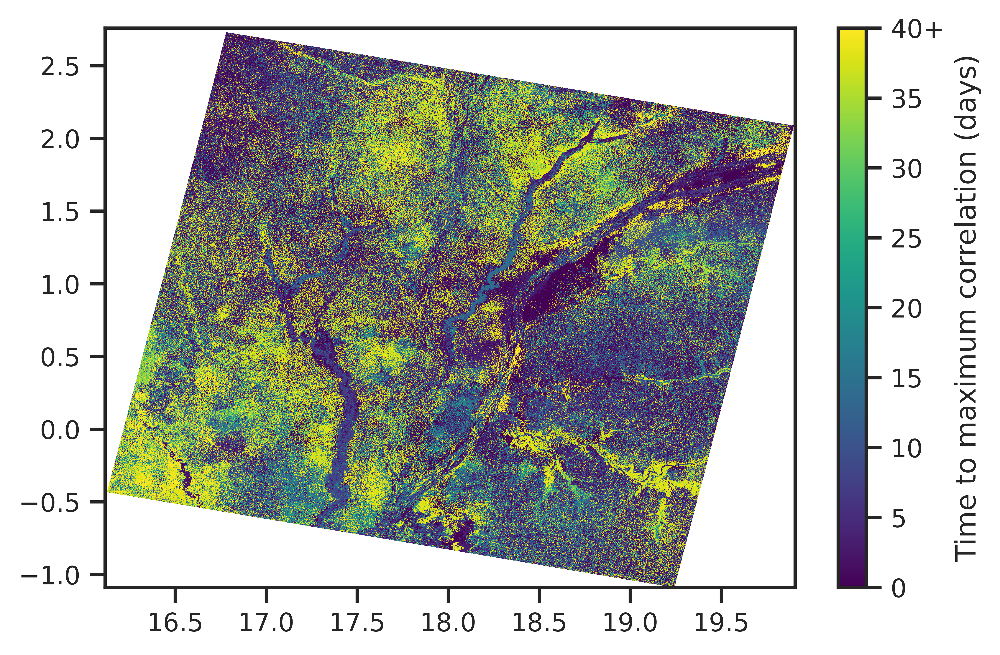

In [42]:
fig, ax = plt.subplots()
sns.set(font_scale=0.9, rc={'axes.facecolor':'white'}, style='ticks')
cax = corrs_HH_max.rename({'correlation': 'time to max correlation (days)'})['time to max correlation (days)'].plot(cmap='viridis', add_colorbar=False)
plt.xlabel('')
plt.xticks([16.5,17,17.5,18,18.5,19,19.5])

cbar = fig.colorbar(cax, ticks=[0,5,10,15,20,25,30,35,40])
cbar.set_label('Time to maximum correlation (days)')
cbar.ax.set_yticklabels(['0','5','10','15','20','25','30','35','40+']) 
plt.ylabel('')
#plt.title('Maximum number of days that HH backscatter\ncorrelates with net water accumulation')


In [ ]:
# Time of maximum correlation where the minimum p-value across the ndays correlation stack is <0.05
# i.e., locations that are rainfed for at least part of the study period
corrs_HH_max2 = corrs_HH_max.where(pvals_min<0.05,drop=True)
fig, ax = plt.subplots()
sns.set(font_scale=0.9, rc={'axes.facecolor':'white'}, style='ticks')
cax = corrs_HH_max2.rename({'correlation': 'time of max correlation (days)'})['time of max correlation (days)'].plot(cmap='viridis', add_colorbar=False)
plt.xlabel('')
plt.xticks([16.5,17,17.5,18,18.5,19,19.5])

cbar = fig.colorbar(cax, ticks=[0,5,10,15,20,25,30,35,40])
cbar.set_label('Time to maximum correlation (days)')
cbar.ax.set_yticklabels(['0','5','10','15','20','25','30','35','40+']) 
plt.ylabel('')
#plt.title('Maximum number of days that HH backscatter\ncorrelates with net water accumulation')


In [ ]:
# Time of maximum correlation where the maximum p-value across the ndays correlation stack is <0.05, 
# i.e., there is always good correlation between the net water input and the SAR backscatter
corrs_HH_max2 = corrs_HH_max.where(pvals_max<0.05,drop=True)
fig, ax = plt.subplots()
sns.set(font_scale=0.9, rc={'axes.facecolor':'white'}, style='ticks')
cax = corrs_HH_max2.rename({'correlation': 'time of max correlation (days)'})['time of max correlation (days)'].plot(cmap='viridis', add_colorbar=False)
plt.xlabel('')
plt.xticks([16.5,17,17.5,18,18.5,19,19.5])

cbar = fig.colorbar(cax, ticks=[0,5,10,15,20,25,30,35,40])
cbar.set_label('Time to maximum correlation (days)')
cbar.ax.set_yticklabels(['0','5','10','15','20','25','30','35','40+']) 
plt.ylabel('')
#plt.title('Maximum number of days that HH backscatter\ncorrelates with net water accumulation')


### Rainfed map

In [ ]:
# Time of maximum correlation where there is good correlation over a minimum of 20 days (the time to midpoint between ALOS images)
# This derivation could be used instead of the pixel-wise correlation statistics to determine rainfed areas
corrs_HH_max2 = corrs_max_peat.where(corrs_HH_max['correlation'] > 19,drop=True)
corrs_HH_max2 = corrs_HH_max2.where(pvals_min<0.05, drop=True)
fig, ax = plt.subplots()
sns.set(font_scale=0.9, rc={'axes.facecolor':'white'}, style='ticks')
cax = corrs_HH_max2.rename({'correlation': 'time of max correlation (days)'})['time of max correlation (days)'].plot(cmap='viridis', add_colorbar=False)
plt.xlabel('')
plt.xticks([16.5,17,17.5,18,18.5,19,19.5])

cbar = fig.colorbar(cax, ticks=[20,25,30,35,40])
cbar.set_label('Time to maximum correlation (days)')
cbar.ax.set_yticklabels(['20','25','30','35','40+']) 
plt.ylabel('')
#plt.title('Maximum number of days that HH backscatter\ncorrelates with net water accumulation')
